In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import calendar

## Trabajemos en EDA a los Dataframes guardados desde el ETL

### Contamos con 5 dataframes: dos referentes a Homicidios (Hechos y Victimas), dos referentes a Lesionados (Victimas y Hechos) y uno referente a la evolucion de la poblacion de CABA entre los años en estudio 2016-2021

In [2]:
# Leer el archivo CSV y asegúr de que no se cree una nueva columna "Unnamed: 0"
df_homicidiosHechos = pd.read_csv('..//data//homicidios_hechos_etl.csv', index_col=0)

# Eliminar la columna "Unnamed: 0" si existe
if "Unnamed: 0" in df_homicidiosHechos.columns:
    df_homicidiosHechos.drop("Unnamed: 0", axis=1, inplace=True)

In [3]:
df_homicidiosHechos.head(1)

,ID_SINIESTRO,VICTIMAS,AÑO,MES,DIA,HORA,DIRECCION,DIRECCION_NORMALIZADA,COMUNA,XY_CABA,LONGITUD,LATITUD,PARTICIPANTES,VICTIMA,ACUSADO
0,2016-0001,1,2016,1,1,4:00:00,Av Piedra Buena Y Av Fernandez De La Cruz,"Piedra Buena Av. Y Fernandez De La Cruz, F., G...",8,"98896.78238426, 93532.43437792",-58.47534,-34.68757,Moto-Auto,Moto,Auto


In [4]:
# Leer el archivo CSV y asegúr de que no se cree una nueva columna "Unnamed: 0"
df_homicidiosVictimas = pd.read_csv('..//data//homicidios_victimas_etl.csv', index_col=0)

# Eliminar la columna "Unnamed: 0" si existe
if "Unnamed: 0" in df_homicidiosVictimas.columns:
    df_homicidiosVictimas.drop("Unnamed: 0", axis=1, inplace=True)

In [5]:
df_homicidiosVictimas.head(1)

,ID_SINIESTRO,AÑO,MES,DIA,ROL,VICTIMA,SEXO,EDAD,FECHA_FALLECIMIENTO
0,2016-0001,2016,1,1,Conductor,Moto,Masculino,19,1/1/2016


In [6]:
# Leer el archivo CSV y asegúr de que no se cree una nueva columna "Unnamed: 0"
df_lesionesHechos = pd.read_csv('..//data//lesiones_hechos_etl.csv', index_col=0)

# Eliminar la columna "Unnamed: 0" si existe
if "Unnamed: 0" in df_lesionesHechos.columns:
    df_lesionesHechos.drop("Unnamed: 0", axis=1, inplace=True)

In [7]:
df_lesionesHechos.head(1)

,ID_LESIONES,VICTIMAS,AÑO,MES,DIA,HORA,DIRECCION_NORMALIZADA,DIRECCION,XY_CABA,LONGITUD,LATITUD,VICTIMA,ACUSADO,PARTICIPANTES
0,LC-2019-0000179,1,2019,1,1,9:00,"Obligado Rafael, Av.Costanera 3300, Barrio: Pa...","Obligado Rafael, Av.Costanera 3300, Barrio: Pa...","104991.46333918849995825, 107720.9664748142677...",-58.408911,-34.559658,Ciclista,Sd,Ciclista-Sd


In [8]:
# Leer el archivo CSV y asegúr de que no se cree una nueva columna "Unnamed: 0"
df_lesionesVictimas = pd.read_csv('..//data//lesiones_victimas_etl.csv', index_col=0)

# Eliminar la columna "Unnamed: 0" si existe
if "Unnamed: 0" in df_lesionesVictimas.columns:
    df_lesionesVictimas.drop("Unnamed: 0", axis=1, inplace=True)

In [9]:
df_lesionesVictimas.head(1)

,ID_LESIONES,AÑO,MES,DIA,VEHICULO_VICTIMA,SEXO,EDAD_VICTIMA
0,LC-2019-0000053,2019,1,1,Sd,Varon,57


In [10]:
# Leer el archivo CSV y abrir Dataframe de la Poblacion
df_poblacion_CABA = pd.read_csv('..//data//poblacion_CABA.csv', index_col=0)
df_poblacion_CABA.head(1)

,TOTAL,AÑO
0,3018777,2016


### Revisemos las Tendencias y Distribuciones comparativas de los Hechos/Homicidios y Hechos/Lesionados 

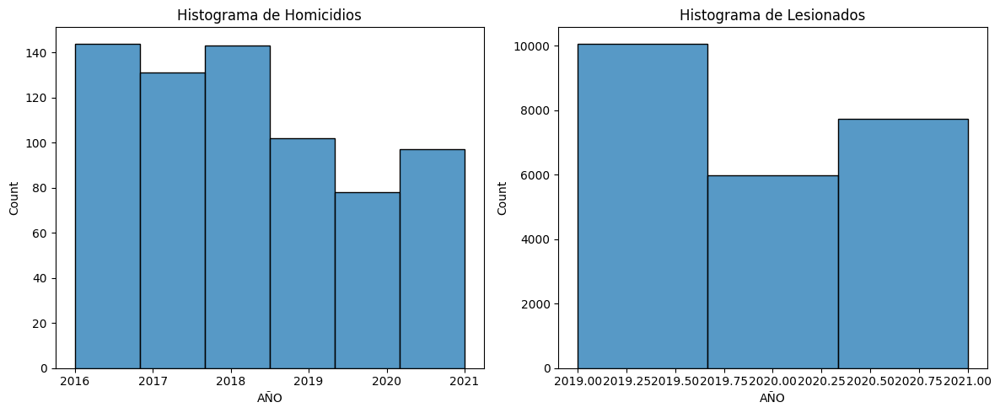

In [11]:
# Crear una figura con dos subplots
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

# Primer histograma (homicidios)
sns.histplot(data=df_homicidiosHechos, x='AÑO', bins=6, ax=axs[0])
axs[0].set_title('Histograma de Homicidios')

# Segundo histograma (lesionados)
sns.histplot(data=df_lesionesHechos, x='AÑO', bins=3, ax=axs[1])
axs[1].set_title('Histograma de Lesionados')

# Ajustar el diseño
plt.tight_layout()

# Mostrar los histogramas
plt.show()

Podriamos interpretar: A pesar de solo tener información de Lesionados para los años 2019, 2020 y 2021. Existe una dsitribucion muy parecida entre Homicidios y Lesionados, Asi mismo de forma grafica podriamos intuir una proporcion de Un (01) Homicidio por cada Noventa (90) Lesionados aproximadamente. 

In [12]:
# Agrupar los homicidios por año
df_homicidios_agg = df_homicidiosHechos.groupby('AÑO').size().reset_index(name='conteo')
df_homicidios_agg['tipo'] = 'Homicidios'

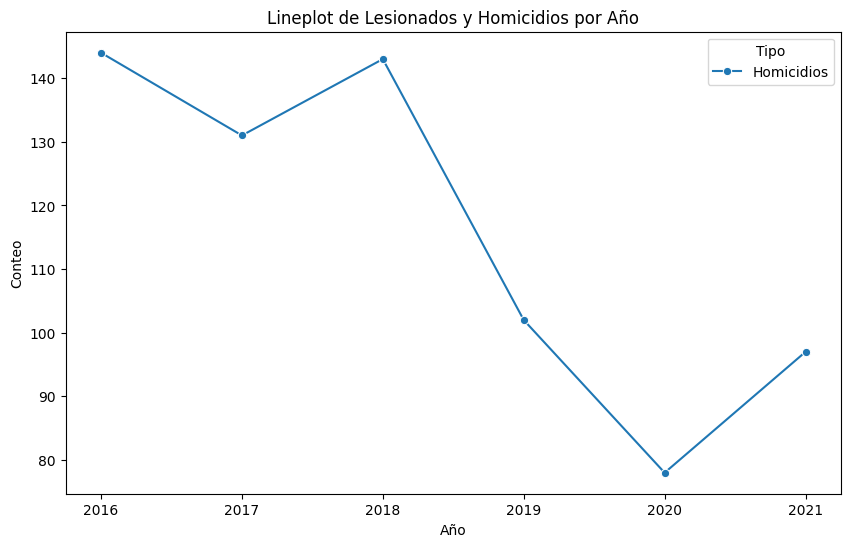

In [13]:
# Crear el lineplot
plt.figure(figsize=(10, 6))
sns.lineplot(x='AÑO', y='conteo', hue='tipo', data=df_homicidios_agg, marker='o')
plt.title('Lineplot de Lesionados y Homicidios por Año')
plt.xlabel('Año')
plt.ylabel('Conteo')
plt.legend(title='Tipo')
plt.show()

In [14]:
# Agrupar los lesionados por año
df_lesionados_agg = df_lesionesHechos.groupby('AÑO').size().reset_index(name='conteo')
df_lesionados_agg['tipo'] = 'Lesionados'

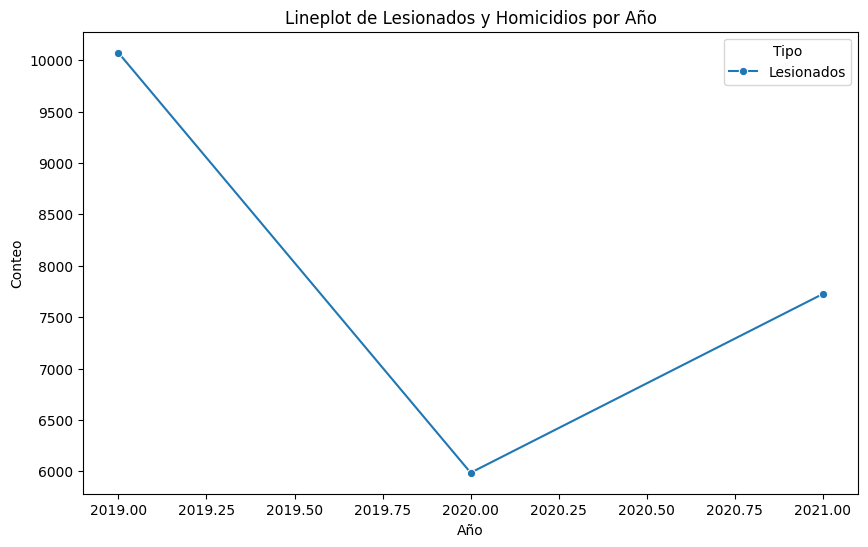

In [15]:
# Crear el lineplot
plt.figure(figsize=(10, 6))
sns.lineplot(x='AÑO', y='conteo', hue='tipo', data=df_lesionados_agg, marker='o')
plt.title('Lineplot de Lesionados y Homicidios por Año')
plt.xlabel('Año')
plt.ylabel('Conteo')
plt.legend(title='Tipo')
plt.show()

Revision de graficos de Bigote para los casos de Lesionados y de Homicidios por separado, en realidad no nos aporta mayor interpretacion. 

### Revisemos la localizacion geografica de los casos de Homicidios - Lesionados

In [15]:
# Calcular la ubicación central de los puntos
latitud_central = df_homicidiosHechos['LATITUD'].mean()  # Promedio de latitudes
longitud_central = df_homicidiosHechos['LONGITUD'].mean()  # Promedio de longitudes

# Crear un mapa base centrado en la ubicación central
mapa = folium.Map(location=[latitud_central, longitud_central], zoom_start=10)

# Crear un grupo de marcadores para los homicidios
grupo_homicidios = MarkerCluster(name='Homicidios').add_to(mapa)
for index, row in df_homicidiosHechos.iterrows():
    # Verificar si la latitud y longitud son valores numéricos
    if pd.notnull(row['LATITUD']) and pd.notnull(row['LONGITUD']):
        folium.Marker(location=[row['LATITUD'], row['LONGITUD']], 
                      popup='Homicidio ID: {}'.format(row['ID_SINIESTRO']), 
                      icon=folium.Icon(color='darkred')).add_to(grupo_homicidios)

# Crear un grupo de marcadores para los lesionados
grupo_lesionados = MarkerCluster(name='Lesionados').add_to(mapa)
for index, row in df_lesionesHechos.iterrows():
    # Verificar si la latitud y longitud son valores numéricos
    if pd.notnull(row['LATITUD']) and pd.notnull(row['LONGITUD']):
        folium.Marker(location=[row['LATITUD'], row['LONGITUD']], 
                      popup='Lesionado ID: {}'.format(row['ID_LESIONES']), 
                      icon=folium.Icon(color='darkblue')).add_to(grupo_lesionados)

# Agregar control de capas al mapa
folium.LayerControl().add_to(mapa)

# Guardar el mapa como archivo HTML
mapa.save('mapa_homicidios_lesionados.html')

# Mostrar el mapa en el notebook (opcional)
mapa

Claremente se observa que existe una mayor proporcion de Homicidios segun exista mayor cantidad de Lesionados, una relacion directamente proporcional, lo que nos indica que practicamente la diferencia entre Homicidios y Lesionados es solo la intencidad del accidente. 

### Revisemos la incidencia del tipo de Vehiculo (Victima) en el Accidente tanto en Homicidios como en Lesionados

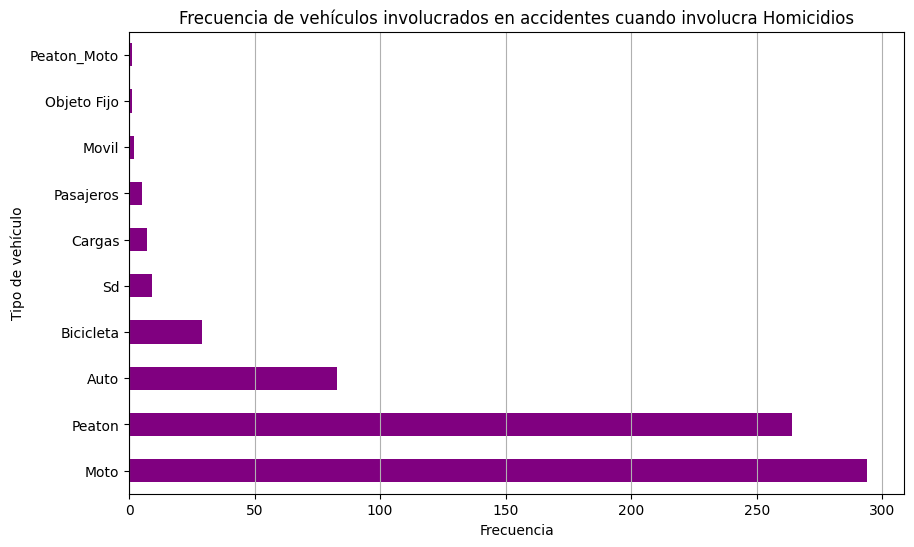

In [16]:
# Contar la frecuencia de cada tipo de vehículo
frecuencia_vehiculos = df_homicidiosHechos['VICTIMA'].value_counts()

# Crear el gráfico de barras horizontales
plt.figure(figsize=(10, 6))
frecuencia_vehiculos.plot(kind='barh', color='purple')
plt.title('Frecuencia de vehículos involucrados en accidentes cuando involucra Homicidios')
plt.xlabel('Frecuencia')
plt.ylabel('Tipo de vehículo')
plt.grid(axis='x')  # Agregar una cuadrícula en el eje x para una mejor visualización
plt.show()

Claramente el grafico indica la gran incidencia de Homicidios en caso que la victima sea Motorizados y/o Peatones. 
En el Mapa vimos la relacion de Accidentes y Lesionados con Homicidios, lo quye no hizo intuir que el punto detonante era la intencidad del mismo. 
Este grafico de proporcionalidad de Victimas, nos hace concluir sobre el punto del mapa, ya que tanto motos como peatones son siempre las victimas que pueden sufrir mas intencidad en un accidente de transito, por tener menos seguridad.

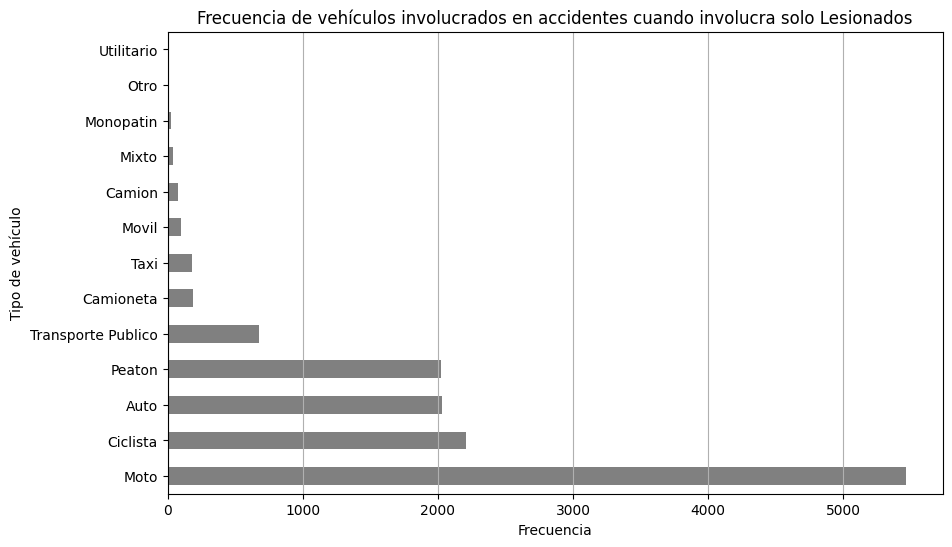

In [17]:
# Filtrar los valores que no sean "SD"
df_lesionesHechos_filtrado = df_lesionesHechos[df_lesionesHechos['VICTIMA'] != 'Sd']

# Contar la frecuencia de cada tipo de vehículo
frecuencia_vehiculos = df_lesionesHechos_filtrado['VICTIMA'].value_counts()

# Crear el gráfico de barras horizontales
plt.figure(figsize=(10, 6))
frecuencia_vehiculos.plot(kind='barh', color='grey')
plt.title('Frecuencia de vehículos involucrados en accidentes cuando involucra solo Lesionados')
plt.xlabel('Frecuencia')
plt.ylabel('Tipo de vehículo')
plt.grid(axis='x')  # Agregar una cuadrícula en el eje x para una mejor visualización
plt.show()

No considerando los la aparicion de SD (Sin Datos) como pareto, ya que en realidad no nos dice nada

Observamos la aparicion de Auto con una misma proporcion con Peaton y Ciclista, uniendo este grafico a la informacion del grafcio de Homicidios y al Mapa, podemos decir que los accidentes de Autos como victima produce alta incidencia en Lesionados y baja proporcionalidad en Homicidios por tener mas seguridad y proteccion para mayores intensidades que en los Peatones y Ciclistas.

Ya que no podemos considerar los SD, si podemos comprobar que los Lesionados de Moto son los de mayor incidencia, exsite una gran relacion con los Homicidios dodne las Moto son victimas.

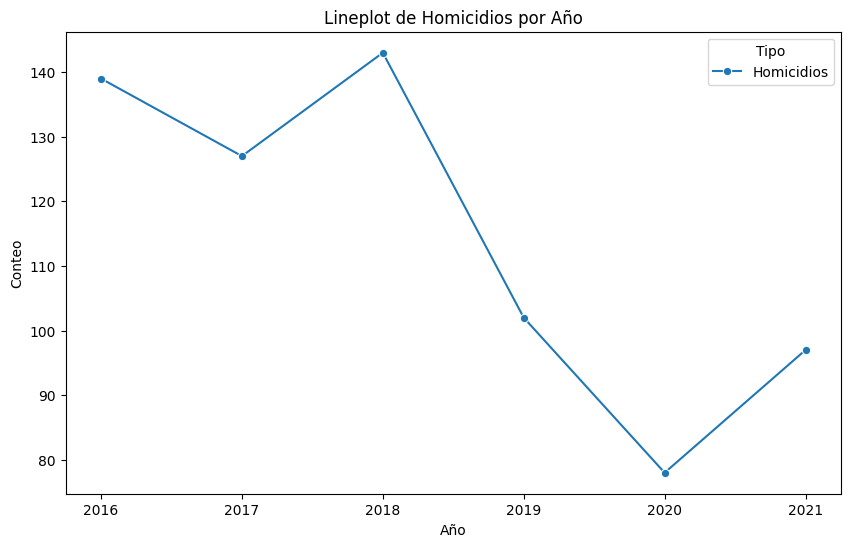

In [18]:
# Filtrar los datos para omitir donde VICTIMA es igual a 'Sd'
df_homicidiosHechos_filtrado = df_homicidiosHechos[df_homicidiosHechos['VICTIMA'] != 'Sd']

# Agrupar los homicidios por año
df_homicidios_agg = df_homicidiosHechos_filtrado.groupby('AÑO').size().reset_index(name='conteo')
df_homicidios_agg['tipo'] = 'Homicidios'

# Crear el lineplot
plt.figure(figsize=(10, 6))
sns.lineplot(x='AÑO', y='conteo', hue='tipo', data=df_homicidios_agg, marker='o')
plt.title('Lineplot de Homicidios por Año')
plt.xlabel('Año')
plt.ylabel('Conteo')
plt.legend(title='Tipo')
plt.show()

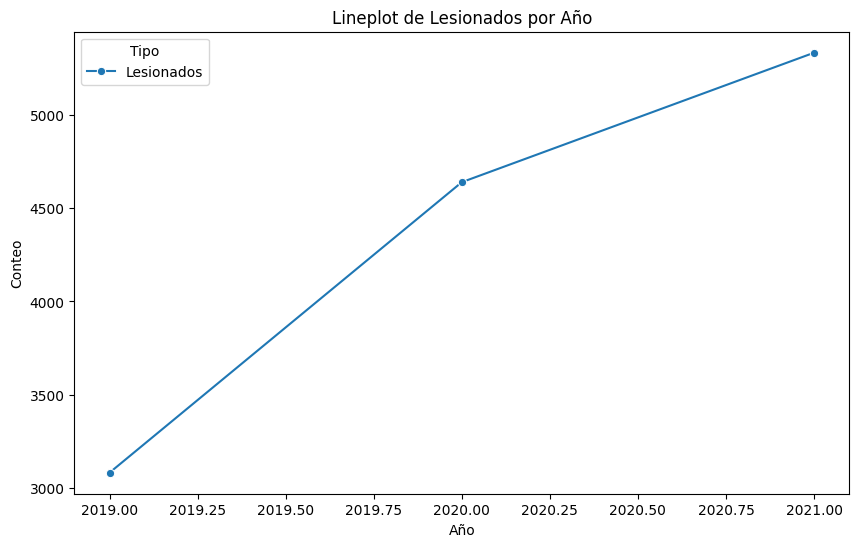

In [19]:
# Filtrar los datos para omitir donde VICTIMA es igual a 'Sd'
df_lesionesHechos_filtrado = df_lesionesHechos[df_lesionesHechos['VICTIMA'] != 'Sd']

# Agrupar los homicidios por año
df_homicidios_agg = df_lesionesHechos_filtrado.groupby('AÑO').size().reset_index(name='conteo')
df_homicidios_agg['tipo'] = 'Lesionados'

# Crear el lineplot
plt.figure(figsize=(10, 6))
sns.lineplot(x='AÑO', y='conteo', hue='tipo', data=df_homicidios_agg, marker='o')
plt.title('Lineplot de Lesionados por Año')
plt.xlabel('Año')
plt.ylabel('Conteo')
plt.legend(title='Tipo')
plt.show()

### Evaluemos la incidencia de la Hora de ocurrencia del Accidente

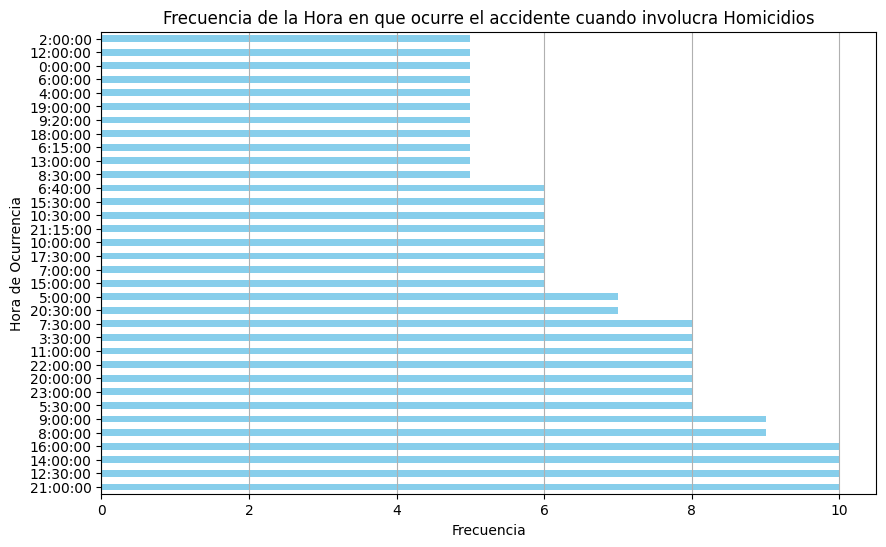

In [20]:
# Calcular el 20% de las horas con mayor frecuencia
porcentaje = 0.05
total_horas = len(df_homicidiosHechos)
cantidad_a_mostrar = int(total_horas * porcentaje)

# Contar la frecuencia de accidentes segun la Hora de ocurrencia
frecuencia_vehiculos = df_homicidiosHechos['HORA'].value_counts()

# Filtrar para mostrar solo el 20% de las horas con mayor frecuencia
frecuencia_vehiculos = frecuencia_vehiculos.head(cantidad_a_mostrar)

# Crear el gráfico de barras horizontales
plt.figure(figsize=(10, 6))
frecuencia_vehiculos.plot(kind='barh', color='skyblue')
plt.title('Frecuencia de la Hora en que ocurre el accidente cuando involucra Homicidios')
plt.xlabel('Frecuencia')
plt.ylabel('Hora de Ocurrencia')
plt.grid(axis='x')  # Agregar una cuadrícula en el eje x para una mejor visualización
plt.show()

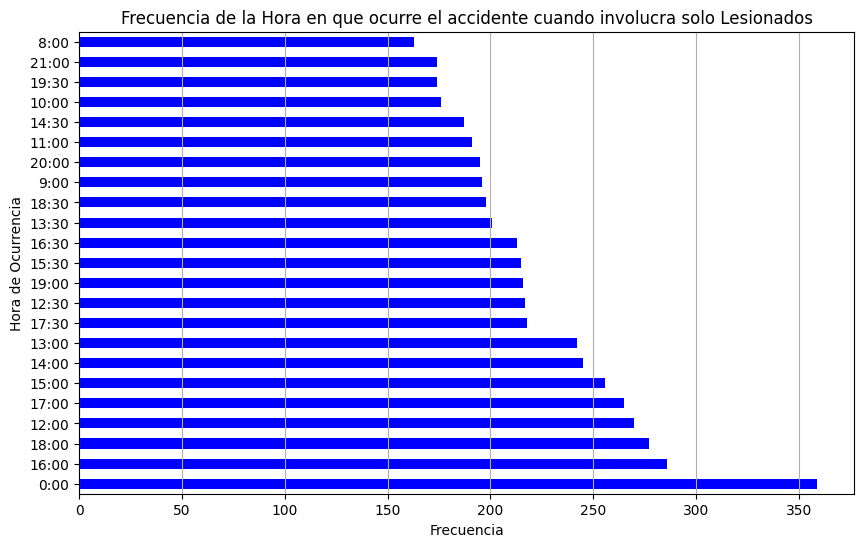

In [21]:
# Calcular el 20% de las horas con mayor frecuencia
porcentaje = 0.001
total_horas = len(df_lesionesHechos)
cantidad_a_mostrar = int(total_horas * porcentaje)

# Contar la frecuencia de accidentes segun la Hora de ocurrencia
frecuencia_vehiculos = df_lesionesHechos['HORA'].value_counts()

# Filtrar para mostrar solo el 20% de las horas con mayor frecuencia
frecuencia_vehiculos = frecuencia_vehiculos.head(cantidad_a_mostrar)

# Crear el gráfico de barras horizontales
plt.figure(figsize=(10, 6))
frecuencia_vehiculos.plot(kind='barh', color='blue')
plt.title('Frecuencia de la Hora en que ocurre el accidente cuando involucra solo Lesionados')
plt.xlabel('Frecuencia')
plt.ylabel('Hora de Ocurrencia')
plt.grid(axis='x')  # Agregar una cuadrícula en el eje x para una mejor visualización
plt.show()

Para el Grafico de Homicidios tomamos el 5% mas freceunte y par a el de solo Lesionados tomamos el 1% de los mas freceutnes, Al graficar inicialmente el 100% en ambos graficos.

Observamos una distribucion muy amplia en el ancho de toda la franja horaria del día.

Concluimos que no existe una incidencia directa entre la hora de ocurrencia del accidente y el resultados de Lesionado y/o Homicidio

### Evaluemos comparativamente Sexo y Edad de Accidentes que involucra Homicidios y solo Lesionados

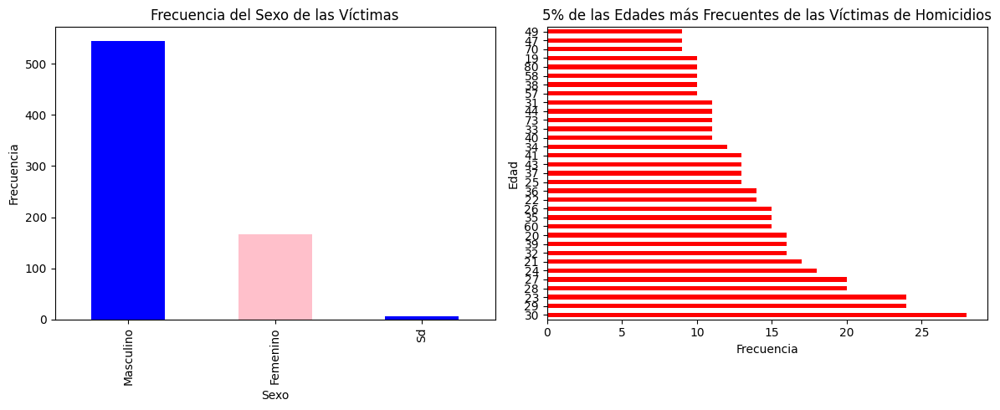

In [22]:
# Filtrar los valores que no sean "SD" en la columna 'EDAD'
df_homicidiosVictimas_filtrado = df_homicidiosVictimas[df_homicidiosVictimas['EDAD'] != 'SD']

# Calcular el 5% de las edades con mayor frecuencia
porcentaje = 0.05
total_edades = len(df_homicidiosVictimas_filtrado)
cantidad_a_mostrar = int(total_edades * porcentaje)

# Contar la frecuencia de las edades de las víctimas
frecuencia_edades = df_homicidiosVictimas_filtrado['EDAD'].value_counts()

# Filtrar para mostrar solo el 5% de las edades con mayor frecuencia
edades_mas_frecuentes = frecuencia_edades.head(cantidad_a_mostrar)

# Graficar la frecuencia del sexo de las víctimas
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)  # Subplot para el sexo
sexo_frecuencia = df_homicidiosVictimas['SEXO'].value_counts()
sexo_frecuencia.plot(kind='bar', color=['blue', 'pink'])
plt.title('Frecuencia del Sexo de las Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Frecuencia')

# Graficar la proporción de la edad de las víctimas
plt.subplot(1, 2, 2)  # Subplot para la edad
edades_mas_frecuentes.plot(kind='barh', color='red')
plt.title('5% de las Edades más Frecuentes de las Víctimas de Homicidios')
plt.xlabel('Frecuencia')
plt.ylabel('Edad')

plt.tight_layout()  # Ajustar la disposición de los gráficos
plt.show()

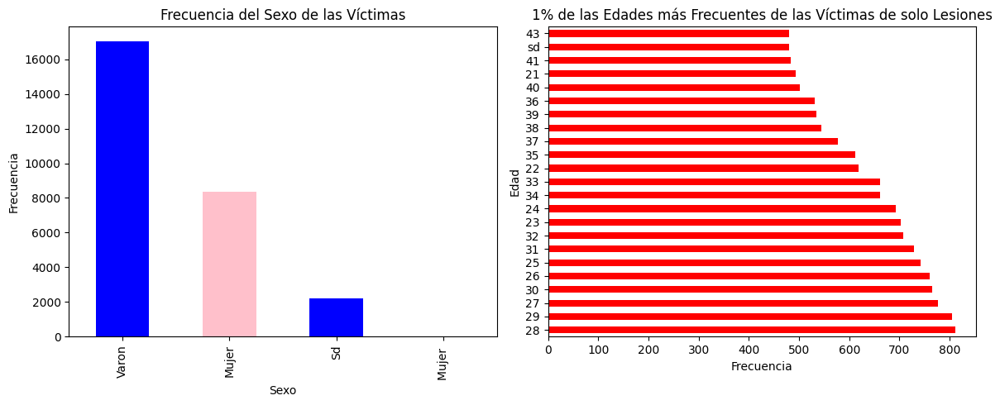

In [23]:
# Filtrar los valores que no sean "SD" en la columna 'EDAD'
df_lesionesVictimas_filtrado = df_lesionesVictimas[df_lesionesVictimas['EDAD_VICTIMA'] != 'SD']

# Calcular el 40% de las edades con mayor frecuencia
porcentaje = 0.001
total_edades = len(df_lesionesVictimas_filtrado)
cantidad_a_mostrar = int(total_edades * porcentaje)

# Contar la frecuencia de las edades de las víctimas
frecuencia_edades = df_lesionesVictimas_filtrado['EDAD_VICTIMA'].value_counts()

# Filtrar para mostrar solo el 40% de las edades con mayor frecuencia
edades_mas_frecuentes = frecuencia_edades.head(cantidad_a_mostrar)

# Graficar la frecuencia del sexo de las víctimas
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)  # Subplot para el sexo
sexo_frecuencia = df_lesionesVictimas['SEXO'].value_counts()
sexo_frecuencia.plot(kind='bar', color=['blue', 'pink'])
plt.title('Frecuencia del Sexo de las Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Frecuencia')

# Graficar la proporción de la edad de las víctimas
plt.subplot(1, 2, 2)  # Subplot para la edad
edades_mas_frecuentes.plot(kind='barh', color='red')
plt.title('1% de las Edades más Frecuentes de las Víctimas de solo Lesiones')
plt.xlabel('Frecuencia')
plt.ylabel('Edad')

plt.tight_layout()  # Ajustar la disposición de los gráficos
plt.show()

Podemos concluir:

No existe una relación directa de la edad de la victima, ni para Lesionados ni para Homicidios. Se observa una distribucion un extensa y equitativa para las edades en general, esto obviado los SD (Sin Datos)

La proporcion de Hombres vs Mujeres es mayor al doble, tanto para Lesiones como para Homicidios. podria estar relacionado con la mayor proporcion de motociclistas Hombres vs motociclistas Mujeres.

### Evaluemos la relacion en la frecuencia de ocurrencia de Lesiones y Homicidios para cada mes del año

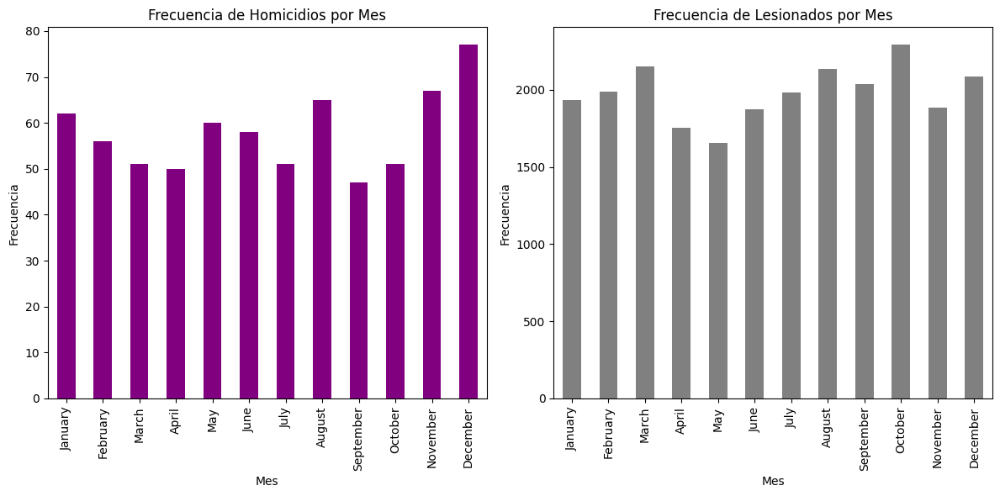

In [24]:
# Obtener nombres de los meses
nombres_meses = [calendar.month_name[i] for i in range(1, 13)]

# Graficar la frecuencia de homicidios por mes
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)  # Subplot para homicidios
df_homicidiosHechos['MES'].value_counts().sort_index().plot(kind='bar', color='purple')
plt.title('Frecuencia de Homicidios por Mes')
plt.xlabel('Mes')
plt.ylabel('Frecuencia')
plt.xticks(range(12), nombres_meses)  # Reemplazar los números de mes por nombres de mes

# Graficar la frecuencia de lesionados por mes
plt.subplot(1, 2, 2)  # Subplot para lesionados
df_lesionesHechos['MES'].value_counts().sort_index().plot(kind='bar', color='grey')
plt.title('Frecuencia de Lesionados por Mes')
plt.xlabel('Mes')
plt.ylabel('Frecuencia')
plt.xticks(range(12), nombres_meses)  # Reemplazar los números de mes por nombres de mes

plt.tight_layout()  # Ajustar la disposición de los gráficos
plt.show()

Existe una relacion entre Lesionados vs Homicidios, aunque no tan directa si se observa su existencia

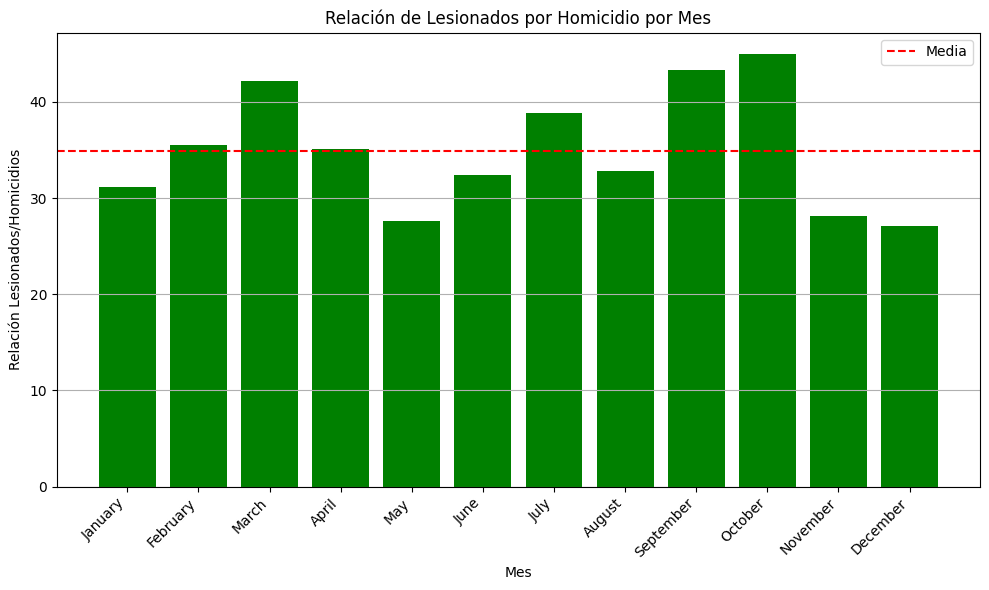

In [25]:
# Obtener nombres de los meses
nombres_meses = [calendar.month_name[i] for i in range(1, 13)]

# Calcular la relación de lesionados por homicidio para cada mes
relacion_lesionados_homicidio = {}
for mes in range(1, 13):
    lesionados_mes = df_lesionesHechos[df_lesionesHechos['MES'] == mes].shape[0]
    homicidios_mes = df_homicidiosHechos[df_homicidiosHechos['MES'] == mes].shape[0]
    relacion_lesionados_homicidio[nombres_meses[mes-1]] = lesionados_mes / homicidios_mes
    
# Calcular la media de la relación de lesionados por homicidio
media_relacion = sum(relacion_lesionados_homicidio.values()) / len(relacion_lesionados_homicidio)

# Graficar la relación de lesionados por homicidio por mes
plt.figure(figsize=(10, 6))
plt.bar(relacion_lesionados_homicidio.keys(), relacion_lesionados_homicidio.values(), color='green')
plt.axhline(y=media_relacion, color='red', linestyle='--', label='Media')
plt.title('Relación de Lesionados por Homicidio por Mes')
plt.xlabel('Mes')
plt.ylabel('Relación Lesionados/Homicidios')
plt.xticks(rotation=45, ha='right')  # Rotar las etiquetas del eje x para una mejor visualización
plt.grid(axis='y')  # Agregar una cuadrícula en el eje y para una mejor visualización
plt.legend()  # Mostrar la leyenda
plt.tight_layout()
plt.show()

Observamos que en los meses de Enero, Febrero, Agosto, Noviembre y Diciembre. La relacion Lesionados vs Homicidios fue mas baja la cantidad de Lesionados por Homicidios, tanto asi como muy por debajo de la media del año.

Comparando con el grafico anterior, donde estos mismos meses representaron numericamente la mayor cantidad de Homicidios, podemos concluir que los accidentes ocurridos estos meses fueron de mucha mas intensidad que en el resto de los meses.

In [26]:
# Agrupar por 'AÑO' y sumar la columna 'VICTIMAS'
df_lesionadosAño = df_lesionesHechos.groupby('AÑO', as_index=False)['VICTIMAS'].sum()

# Renombrar la columna 'VICTIMAS' a 'LESIONADOS'
df_lesionadosAño.rename(columns={'VICTIMAS': 'LESIONADOS'}, inplace=True)

# Agrupar por 'AÑO' y sumar la columna 'VICTIMAS'
df_homicidiosAño = df_homicidiosHechos.groupby('AÑO', as_index=False)['VICTIMAS'].sum()

# Renombrar la columna 'VICTIMAS' a 'LESIONADOS'
df_homicidiosAño.rename(columns={'VICTIMAS': 'HOMICIDIOS'}, inplace=True)

In [27]:
# Combinar los DataFrames considerando solo los años presentes en ambos
df_homicidios_lesionados = pd.merge(df_lesionadosAño, df_homicidiosAño, on='AÑO', how='inner')

#Crear una columna 'LESIONADOS_HOMICIDIO' la cual nos indica el numero de Lesionados que ocurren antes de haber un Homicidio
df_homicidios_lesionados['LESIONADOS_HOMICIDIO'] = df_homicidios_lesionados['LESIONADOS'] / df_homicidios_lesionados['HOMICIDIOS']

df_homicidios_lesionados

,AÑO,LESIONADOS,HOMICIDIOS,LESIONADOS_HOMICIDIO
0,2019,11792,103,114.485437
1,2020,6855,81,84.629630
2,2021,8957,97,92.340206


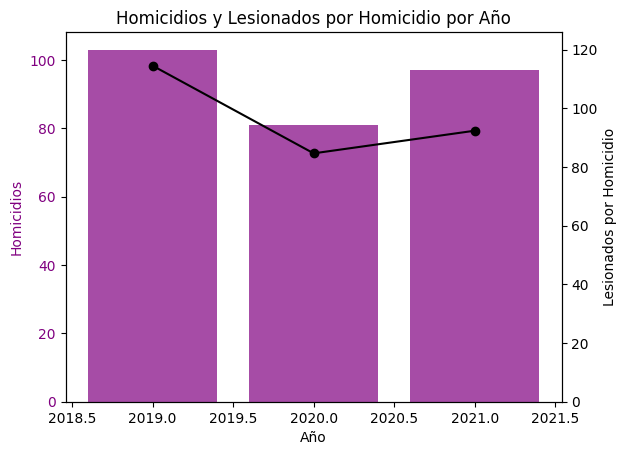

In [28]:
# Crear el gráfico
fig, ax1 = plt.subplots()

# Graficar Homicidios en el eje Y izquierdo
ax1.bar(df_homicidios_lesionados['AÑO'], df_homicidios_lesionados['HOMICIDIOS'], color='purple', alpha=0.7)
ax1.set_xlabel('Año')
ax1.set_ylabel('Homicidios', color='purple')
ax1.tick_params(axis='y', labelcolor='purple')

# Crear un segundo eje Y para Lesionados_por_Homicidio
ax2 = ax1.twinx()
ax2.plot(df_homicidios_lesionados['AÑO'], df_homicidios_lesionados['LESIONADOS_HOMICIDIO'], color='k', marker='o', linestyle='-')
ax2.set_ylabel('Lesionados por Homicidio', color='k')
ax2.tick_params(axis='y', labelcolor='k')

# Ajustar la escala del segundo eje Y
ax2.set_ylim(0, max(df_homicidios_lesionados['LESIONADOS_HOMICIDIO']) * 1.1)

# Mostrar el gráfico
plt.title('Homicidios y Lesionados por Homicidio por Año')
plt.show()

Estamos concluyendo que la frecuencia de ocurrencia de Lesionados y de Homicidios es muy relacionada entre ellas

Seguimos viendo que prevenir Accidentes, disminuye la posibilidades de Lesiones, y por dependencia de proporcionalidad disminuye los Homicidios

Tambien podemos atacar la proporcion que existe de Lesiones por cad Homicidio, esto seria, que matematicamente dependan menos y sea menos proporcional. Atacando factores que hacer que la intencidad sea causante del Homiciido, Sabiendo de analisis anteriores, que el pareto de Homicidios es Peatones y Motorizados.

### Evaluemos la dispersion de las Ubicaciones respecto a las Victimas para Homicidios

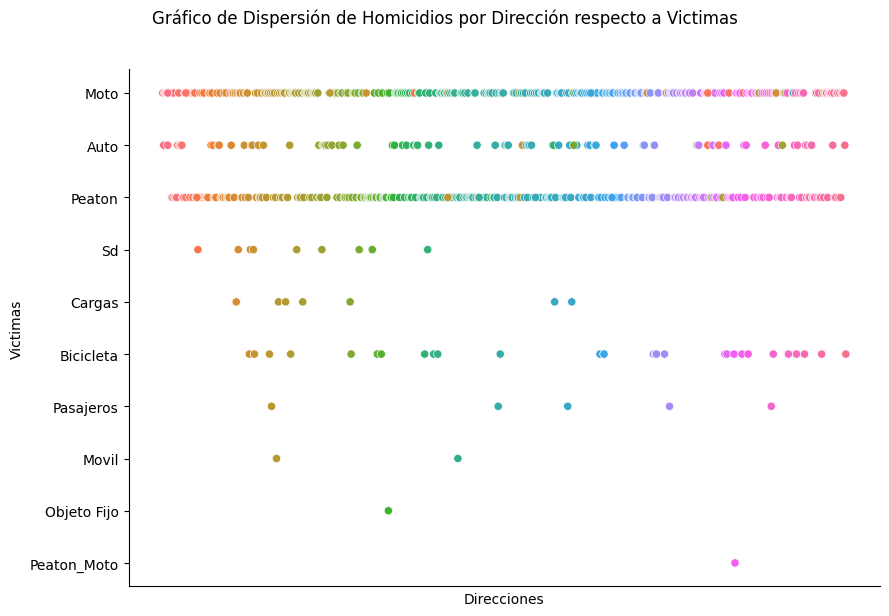

In [42]:
# Filtrar ubicaciones que no sean "SD"
df_homicidios_filtrado = df_homicidiosHechos[(df_homicidiosHechos['DIRECCION_NORMALIZADA'] != 'Sd') & (df_homicidiosHechos['DIRECCION_NORMALIZADA'].notna())]

# Crear el gráfico de dispersión
g = sns.relplot(data=df_homicidios_filtrado, x='DIRECCION', y='VICTIMA', hue='DIRECCION_NORMALIZADA', kind='scatter', height=6, aspect=1.5, legend=False)

# Ajustar el layout para una mejor visualización
g.fig.suptitle('Gráfico de Dispersión de Homicidios por Dirección respecto a Victimas', y=1.02)
g.set_axis_labels("Direcciones", "Victimas")  # Eliminar la etiqueta del eje X

# Desactivar los ejes X
g.set(xticks=[])

plt.tight_layout()
plt.show()

El Grafico es muy claro para la dispercion de las victimas a todo el ancho de las opciones de direcciones del Dataframe.

Asi mismo evidencia aun mas las Motos y Peatones como paretos en Homicidios por Accidentes de Transito, con una diferencia muy notoria respecto a las otras victimas

La leyenda del Label del eje X no se coloco ya que no agregaba valor a lo que se buscaba con este grafico y por otro lado al superponerse por ser tan variada estos datos, seria no legible

### Evaluemos el TOP 10 de Ubicaciones para Lesionados y Homicidios

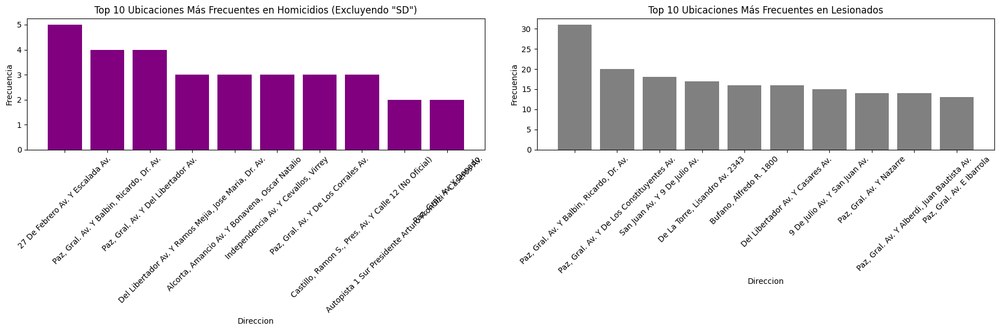

In [43]:
# Filtrar ubicaciones que no sean "SD"
df_homicidios_filtrado = df_homicidiosHechos[(df_homicidiosHechos['DIRECCION_NORMALIZADA'] != 'Sd') & (df_homicidiosHechos['DIRECCION_NORMALIZADA'].notna())]
df_lesionados_filtrado = df_lesionesHechos[(df_lesionesHechos['DIRECCION_NORMALIZADA'] != 'Sd') & (df_lesionesHechos['DIRECCION_NORMALIZADA'].notna())]

# Contar la frecuencia de cada ubicación en el DataFrame de homicidios
frecuencia_homicidios = df_homicidios_filtrado['DIRECCION_NORMALIZADA'].value_counts()

# Contar la frecuencia de cada ubicación en el DataFrame de lesionados
frecuencia_lesionados = df_lesionados_filtrado['DIRECCION_NORMALIZADA'].value_counts()

# Seleccionar las 10 ubicaciones más frecuentes que estén repetidas en el DataFrame de homicidios
top_10_homicidios = frecuencia_homicidios[frecuencia_homicidios > 1].head(10)

# Seleccionar las 10 ubicaciones más frecuentes que estén repetidas en el DataFrame de lesionados
top_10_lesionados = frecuencia_lesionados[frecuencia_lesionados > 1].head(10)

# Crear la figura y los subplots
fig, axs = plt.subplots(1, 2, figsize=(18, 6))

# Graficar las ubicaciones más frecuentes en el DataFrame de homicidios
axs[0].bar(top_10_homicidios.index, top_10_homicidios.values, color='purple')
axs[0].set_title('Top 10 Ubicaciones Más Frecuentes en Homicidios (Excluyendo "SD")')
axs[0].set_xlabel('Direccion')
axs[0].set_ylabel('Frecuencia')
axs[0].tick_params(axis='x', rotation=45)

# Graficar las ubicaciones más frecuentes en el DataFrame de lesionados
axs[1].bar(top_10_lesionados.index, top_10_lesionados.values, color='grey')
axs[1].set_title('Top 10 Ubicaciones Más Frecuentes en Lesionados')
axs[1].set_xlabel('Direccion')
axs[1].set_ylabel('Frecuencia')
axs[1].tick_params(axis='x', rotation=45)

# Ajustar el layout para una mejor visualización
plt.tight_layout()
plt.show()

Observamos que existen Direcciones en las cuales ha habido gran cantidad de Homicidios y de Lesionados, es importante notar que es solo un TOP 10

In [44]:
# Filtrar ubicaciones que no sean "SD" ni vacías
df_homicidios_filtrado = df_homicidiosHechos[(df_homicidiosHechos['DIRECCION_NORMALIZADA'] != 'SD') & (df_homicidiosHechos['DIRECCION_NORMALIZADA'].notna())]
df_lesionados_filtrado = df_lesionesHechos[(df_lesionesHechos['DIRECCION_NORMALIZADA'] != 'SD') & (df_lesionesHechos['DIRECCION_NORMALIZADA'].notna())]

# Contar la frecuencia de cada ubicación en el DataFrame de homicidios
frecuencia_homicidios = df_homicidios_filtrado['DIRECCION_NORMALIZADA'].value_counts()

# Contar la frecuencia de cada ubicación en el DataFrame de lesionados
frecuencia_lesionados = df_lesionados_filtrado['DIRECCION_NORMALIZADA'].value_counts()

# Seleccionar las 10 ubicaciones más frecuentes que estén repetidas en el DataFrame de homicidios
top_10_homicidios = frecuencia_homicidios[frecuencia_homicidios > 1].head(10)

# Seleccionar las 10 ubicaciones más frecuentes que estén repetidas en el DataFrame de lesionados
top_10_lesionados = frecuencia_lesionados[frecuencia_lesionados > 1].head(10)

# Encontrar las ubicaciones comunes entre homicidios y lesionados
ubicaciones_comunes = top_10_homicidios.index.intersection(top_10_lesionados.index)

# Crear un DataFrame con las ubicaciones comunes y sus frecuencias
df_comun = pd.DataFrame({
    'Direccion Normalizada': ubicaciones_comunes,
    'frecuencia_homicidios': top_10_homicidios[ubicaciones_comunes].values,
    'frecuencia_lesionados': top_10_lesionados[ubicaciones_comunes].values
})

df_comun # Imprimimir el Dataframe donde en el TOP 10 de Homicidios y de Lesionados, la Direccion es comun para ambos

,Direccion Normalizada,frecuencia_homicidios,frecuencia_lesionados
0,"Paz, Gral. Av. Y Balbin, Ricardo, Dr. Av.",4,31


Dentro de los TOP 10 de Homicidios y de Lesionados tenemos una direccion comun para ambos, es una Direccion a tomar en cuenta para evaluar riesgos como señalizacion.

In [45]:
# Filtrar ubicaciones que no sean "SD" ni vacías
df_homicidios_filtrado = df_homicidiosHechos[(df_homicidiosHechos['DIRECCION_NORMALIZADA'] != 'Sd') & (df_homicidiosHechos['DIRECCION_NORMALIZADA'].notna())]
df_lesionados_filtrado = df_lesionesHechos[(df_lesionesHechos['DIRECCION_NORMALIZADA'] != 'Sd') & (df_lesionesHechos['DIRECCION_NORMALIZADA'].notna())]

# Contar la frecuencia de cada ubicación en el DataFrame de homicidios
frecuencia_homicidios = df_homicidios_filtrado['DIRECCION_NORMALIZADA'].value_counts()

# Contar la frecuencia de cada ubicación en el DataFrame de lesionados
frecuencia_lesionados = df_lesionados_filtrado['DIRECCION_NORMALIZADA'].value_counts()

# Seleccionar las 10 ubicaciones más frecuentes en el DataFrame de homicidios
top_10_homicidios = frecuencia_homicidios.head(10)

# Seleccionar las 10 ubicaciones más frecuentes en el DataFrame de lesionados
top_10_lesionados = frecuencia_lesionados.head(10)

# Crear un DataFrame con las ubicaciones del Top 10 y sus frecuencias para homicidios
df_top_10_homicidios = pd.DataFrame({
    'direccion normalizada': top_10_homicidios.index,
    'frecuencia': top_10_homicidios.values,
    'tipo': ['Homicidios'] * len(top_10_homicidios)
})

# Crear un DataFrame con las ubicaciones del Top 10 y sus frecuencias para lesionados
df_top_10_lesionados = pd.DataFrame({
    'direccion normalizada': top_10_lesionados.index,
    'frecuencia': top_10_lesionados.values,
    'tipo': ['Lesionados'] * len(top_10_lesionados)
})

# Concatenar los DataFrames de homicidios y lesionados
df_top_10 = pd.concat([df_top_10_homicidios, df_top_10_lesionados])

# Calcular el total de homicidios y lesionados excluyendo "SD" y NaN
total_homicidios = df_homicidios_filtrado.shape[0]
total_lesionados = df_lesionados_filtrado.shape[0]

# Calcular el total de homicidios y lesionados en el Top 10
total_homicidios_top10 = df_top_10_homicidios['frecuencia'].sum()
total_lesionados_top10 = df_top_10_lesionados['frecuencia'].sum()

# Calcular el porcentaje que representan
df_top_10['porcentaje'] = df_top_10.apply(
    lambda row: (row['frecuencia'] / total_homicidios * 100) if row['tipo'] == 'Homicidios' else (row['frecuencia'] / total_lesionados * 100),
    axis=1
)

# Agregar filas de totales al DataFrame
totals_row = pd.DataFrame({
    'direccion normalizada': ['TOTAL', 'TOTAL'],
    'frecuencia': [total_homicidios_top10, total_lesionados_top10],
    'tipo': ['Homicidios', 'Lesionados'],
    'porcentaje': [(total_homicidios_top10 / total_homicidios) * 100, (total_lesionados_top10 / total_lesionados) * 100]
})

df_comun_porcentual = pd.concat([df_top_10, totals_row], ignore_index=True)

# Mostrar el DataFrame resultante
df_comun_porcentual

,direccion normalizada,frecuencia,tipo,porcentaje
0,27 De Febrero Av. Y Escalada Av.,5,Homicidios,0.720461
1,"Paz, Gral. Av. Y Balbin, Ricardo, Dr. Av.",4,Homicidios,0.576369
2,"Paz, Gral. Av. Y Del Libertador Av.",4,Homicidios,0.576369
3,"Del Libertador Av. Y Ramos Mejia, Jose Maria, ...",3,Homicidios,0.432277
4,"Alcorta, Amancio Av. Y Bonavena, Oscar Natalio",3,Homicidios,0.432277
5,"Independencia Av. Y Cevallos, Virrey",3,Homicidios,0.432277
6,"Paz, Gral. Av. Y De Los Corrales Av.",3,Homicidios,0.432277
7,"Castillo, Ramon S., Pres. Av. Y Calle 12 (No O...",3,Homicidios,0.432277
8,Autopista 1 Sur Presidente Arturo Frondizi Y C...,2,Homicidios,0.288184
9,"Paz, Gral. Av. Y Donado",2,Homicidios,0.288184


En el TOP 10 de ubicaciones de Homicidios  y de Lesionados tenemos un 4,6% y 0,94% respectivamente.

Es importante evaluar condiciones o situaciones de señalizacion, estado de las vias u otros, en estas direcciones que representan el TOP 10, incluso ampliar a un TOP 30.

# Evaluemos los KPIs considerados para el analisis de este estudio

#### Reducir en un 10% la tasa de homicidios en siniestros viales de los últimos seis meses en CABA, en comparación con la tasa de homicidios en siniestros viales del semestre anterior.

In [52]:
# Agregar la columna SEMESTRE
df_homicidiosHechos['SEMESTRE'] = df_homicidiosHechos['MES'].apply(lambda x: 1 if x <= 6 else 2)

In [53]:
# Agrupar por año y semestre y contar homicidios
df_homicidiosHechos_Semestre = df_homicidiosHechos.groupby(['AÑO', 'SEMESTRE']).size().reset_index(name='ID_SINIESTRO')

In [54]:
# Hacer Merge con el DataFrame de población por año
df_homicidiosHechos_Semestre = pd.merge(df_homicidiosHechos_Semestre, df_poblacion_CABA, on='AÑO')

In [55]:
# Calcular la tasa de homicidios y agregarla como columna
df_homicidiosHechos_Semestre['TASA_HOMICIDIOS'] = (df_homicidiosHechos_Semestre['ID_SINIESTRO'] / df_homicidiosHechos_Semestre['TOTAL']) * 100000

In [56]:
# Calcular la reduccion respecto al semestre anterior
df_homicidiosHechos_Semestre['REDUCCION'] = (df_homicidiosHechos_Semestre['TASA_HOMICIDIOS'].shift(1) - df_homicidiosHechos_Semestre['TASA_HOMICIDIOS']) / df_homicidiosHechos_Semestre['TASA_HOMICIDIOS'].shift(1) * 100

In [57]:
df_homicidiosHechos_Semestre

,AÑO,SEMESTRE,ID_SINIESTRO,TOTAL,TASA_HOMICIDIOS,REDUCCION
0,2016,1,64,3018777,2.120064,NaN
1,2016,2,80,3018777,2.650080,-25.000000
2,2017,1,64,3040764,2.104734,20.578460
3,2017,2,67,3040764,2.203394,-4.687500
4,2018,1,67,3062912,2.187461,0.723103
5,2018,2,76,3062912,2.481299,-13.432836
6,2019,1,56,3085220,1.815106,26.848571
7,2019,2,46,3085220,1.490980,17.857143
8,2020,1,31,3107692,0.997525,33.096008
9,2020,2,47,3107692,1.512376,-51.612903


In [58]:
# Guarda el DataFrame despues del EDA en un archivo CSV
df_homicidiosHechos_Semestre = df_homicidiosHechos_Semestre.to_csv('..//data//homicidiosHechos_Semestre.csv')

Los valores Positivos en la columna 'REDUCCION' nos indica una reduccion respecto al semestre anterior, por su lado valores negativos indica un aumento. es conveniente evaluar que se ha hecho y dejado de hacer, ya que no existe ningun tipo de tendencia en la reduccion de Homicidios.

Si se ha hecho algun plan de accion este no ha surtido efecto buscado, aunque la falta de tendencia muestra posiblemente que no se ha trabajado ningun plan de accion atacando causas raices.

#### Reducir en un 7% la cantidad de accidentes mortales de motociclistas en el último año, en CABA, respecto al año anterior

In [41]:
# Crear un DataFrame para contar las veces que la víctima fue una moto por año
df_homicidiosHechos_Moto = df_homicidiosHechos[df_homicidiosHechos['VICTIMA'] == 'Moto'].groupby('AÑO').size().reset_index(name='MOTOS')

In [42]:
# Calcular la evolución anual de las víctimas en moto
df_homicidiosHechos_Moto['EVOLUCION_ANUAL'] = ((df_homicidiosHechos_Moto['MOTOS'].shift(1) - df_homicidiosHechos_Moto['MOTOS']) / df_homicidiosHechos_Moto['MOTOS'].shift(1)) * 100

In [43]:
df_homicidiosHechos_Moto

,AÑO,MOTOS,EVOLUCION_ANUAL
0,2016,64,NaN
1,2017,53,17.187500
2,2018,55,-3.773585
3,2019,49,10.909091
4,2020,27,44.897959
5,2021,46,-70.370370


In [44]:
# Guarda el DataFrame despues del EDA en un archivo CSV
df_homicidiosHechos_Moto = df_homicidiosHechos_Moto.to_csv('..//data//homicidiosHechos_Moto.csv')

Valores positivos en la columna 'EVOLUCION_ANUAL' indica reduccion porcentual respecto al año anterior, por su lado valores negativos indica aumento porcentual respecto al año anterior

De manera inmediata podemos repetir parte de las conclusiones en el KPI anterior

Si se ha hecho algun plan de accion este no ha surtido efecto buscado, aunque la falta de tendencia muestra posiblemente que no se ha trabajado ningun plan de accion atacando causas raices.

En analisis anteriores vimos que Motos y Peatones eran la mayor proporcion de Victimas Mortales de Accidentes de Transito

Si bien hay años donde la reduccion ha estado muy por encima de las metas propuestas en la medicion del KPI, lo que seria muy positivo, tambien vemos que este reduccion se pierde muy facilmente al llegar otro año

#### Aumentar la proporción de lesionados por cada homicidio en un 10% anual, respecto al año anterior.

Este KPI se centra en medir y gestionar la relación entre lesionados y homicidios, buscando que cada año se requiera un 10% más de lesionados para que ocurra un homicidio, en comparación con el año anterior. Aunque el objetivo no es incrementar el número de lesionados, en caso de que los incidentes ocurran, queremos asegurarnos de que la tasa de lesionados por homicidio aumente, reflejando una posible mejora en la capacidad de prevención de homicidios.

In [45]:
# Calcular la proporción de Lesionados por Homicidios respecto al año anterior
df_homicidios_lesionados['PROPORCION'] = (df_homicidios_lesionados['LESIONADOS_HOMICIDIO'].shift(1)) * 1.1

# Llenar la primera fila de 'PROPORCION' con 'LESIONADOS_HOMICIDIO'
df_homicidios_lesionados.loc[0, 'PROPORCION'] = df_homicidios_lesionados.loc[0, 'LESIONADOS_HOMICIDIO']

In [46]:
df_homicidios_lesionados

,AÑO,LESIONADOS,HOMICIDIOS,LESIONADOS_HOMICIDIO,PROPORCION
0,2019,11792,103,114.485437,114.485437
1,2020,6855,81,84.629630,125.933981
2,2021,8957,97,92.340206,93.092593


In [47]:
# Guarda el DataFrame despues del EDA en un archivo CSV
df_homicidios_lesionados = df_homicidios_lesionados.to_csv('..//data/homicidios_lesionados.csv')

Nuestra META es la reduccion en un 10% del valor de PROPORCION respecto al AÑO anterior

Podemos intuir lo visto en analisis anteriores de KPIs

Si se ha hecho algun plan de accion este no ha surtido efecto buscado, aunque la falta de tendencia muestra posiblemente que no se ha trabajado ningun plan de accion atacando causas raices.

Si bien en ultimo año en estudio (2021) existe una considerable reduccion ha PROPORCION muy por encima de la meta propuestas en la medicion del KPI, lo que seria muy positivo si fuera repetitivo, tambien vemos que este reduccion viene de un aumento mucho mayor en la relacion en par de años anteriores